# Fantasy Premier League - Team of the Season

In [1]:
import requests, json
from pprint import pprint
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO

Articles used to prepare this code:
- https://towardsdatascience.com/fantasy-premier-league-value-analysis-python-tutorial-using-the-fpl-api-8031edfe9910
- https://www.game-change.co.uk/2023/02/10/a-complete-guide-to-the-fantasy-premier-league-fpl-api/

In [2]:
MANAGER_ID = 2798809

This code gets overall info about manager - name, region, favourite team and leagues:

In [48]:
# overall info
url = 'https://fantasy.premierleague.com/api/entry/'+str(MANAGER_ID)+'/'
r = requests.get(url)
json = r.json()
team_name = json['name']
print(team_name)

Żabka Dębów


This part of code gets history of manager's seasons in FPL.

In [9]:
# manager's history and current season stats
url = 'https://fantasy.premierleague.com/api/entry/'+str(MANAGER_ID)+'/history/'
r = requests.get(url)
json = r.json()
pd.DataFrame(json['current'])

,event,points,total_points,rank,rank_sort,overall_rank,bank,value,event_transfers,event_transfers_cost,points_on_bench
0,1,64,64,2543363,2625970,2543361,0,1000,0,0,4
1,2,54,118,5199752,5228173,3533431,0,1002,0,0,16
2,3,57,175,2030689,2050651,2480198,9,1004,2,0,5
3,4,47,222,8142643,8156497,4243931,5,1008,1,0,8
4,5,68,290,3867491,3894869,3800970,0,1006,0,0,9
5,6,59,349,1050811,1065993,2792720,5,1009,1,0,5
6,7,0,349,1,1509025,2750535,5,1011,0,0,0
7,8,65,414,1333179,1340645,1889899,12,1013,1,0,1
8,9,84,498,2019000,2037314,1531887,5,1014,1,0,6
9,10,65,563,3683406,3704821,1483774,13,1017,2,0,16


Bootstrap-static dataset includes huge amount of information about all gameweeks, Premier League teams, FPL users and chips, information about players, positions, etc. It will be used to create DataFrame with all players.

In [22]:
# full info
url = 'https://fantasy.premierleague.com/api/bootstrap-static/'
r = requests.get(url)
json_bs = r.json()

In [23]:
elements_df = pd.DataFrame(json_bs['elements'])
elements_types_df = pd.DataFrame(json_bs['element_types'])
teams_df = pd.DataFrame(json_bs['teams'])

In [24]:
slim_elements_df = elements_df[['id','first_name' ,'second_name','team','element_type','total_points', 'photo']]
slim_elements_df['position'] = slim_elements_df.element_type.map(elements_types_df.set_index('id').singular_name)
slim_elements_df['team'] = slim_elements_df.team.map(teams_df.set_index('id').name)

C:\Users\Marcin\AppData\Local\Temp\ipykernel_22716\3537679340.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  slim_elements_df['position'] = slim_elements_df.element_type.map(elements_types_df.set_index('id').singular_name)
C:\Users\Marcin\AppData\Local\Temp\ipykernel_22716\3537679340.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  slim_elements_df['team'] = slim_elements_df.team.map(teams_df.set_index('id').name)


In [25]:
players = pd.DataFrame(data=(slim_elements_df[['first_name', 'second_name', 'position', 'team', 'total_points', 'photo']]))
players = players.set_index(slim_elements_df['id'])
players['image'] = np.nan

Downloading player photos is long process - when I was preparing TOTS for entire league, I decided to download them before the process to prevent getting them in each iteration. When I am creating TOTS only for my team, I will download photos only for my players.

In [58]:
# get photos if you create images for multiple managers - it may take some time
for key, row in players.iterrows():
    photo_file = row['photo'].replace('jpg', 'png')
    url = 'https://resources.premierleague.com/premierleague/photos/players/250x250/p'+photo_file
    response = requests.get(url)
    try:
        img = Image.open(BytesIO(response.content))
        players.at[key, 'image'] = img
    except:
        print("image not found for "+row['first_name']+' '+row['second_name'])

image not found for Matthew Smith
image not found for Ethan Nwaneri
image not found for Lino Sousa
image not found for Amario Cozier-Duberry
image not found for Reuell Walters
image not found for Mauro Bandeira
image not found for Anwar El Ghazi
image not found for Kaine Kesler Hayden
image not found for Kadan Young
image not found for Oliwier Zych
image not found for James Wright
image not found for Travis Patterson
image not found for Tommi O'Reilly
image not found for Owen Bevan
image not found for Cameron Plain
image not found for Daniel Adu-Adjei
image not found for Michael Dacosta Gonzalez
image not found for Dominic Sadi
image not found for Euan Pollock
image not found for Ben Greenwood
image not found for Max Kinsey-Wellings
image not found for Ellery Balcombe
image not found for Michael Olakigbe
image not found for Jack Hinshelwood
image not found for Yasin Ayari
image not found for Imari Samuels
image not found for Harvey Vale
image not found for Andrey Nascimento dos Santos


Code in cell below get data for all the season (38 gameweeks). Before iteration I create DataFrame to collect history of players to not download them in every iteration (Trippier would be downloaded 38 times...). Points in the table are multiplied by FPL multiplier, so captain get 2x or 3x points, players on bench get 0 points.

In [26]:
my_points = pd.DataFrame()
players_history = pd.DataFrame(columns=['element', 'fixture', 'opponent_team', 'total_points', 'was_home',
       'kickoff_time', 'team_h_score', 'team_a_score', 'round', 'minutes',
       'goals_scored', 'assists', 'clean_sheets', 'goals_conceded',
       'own_goals', 'penalties_saved', 'penalties_missed', 'yellow_cards',
       'red_cards', 'saves', 'bonus', 'bps', 'influence', 'creativity',
       'threat', 'ict_index', 'starts', 'expected_goals', 'expected_assists',
       'expected_goal_involvements', 'expected_goals_conceded', 'value',
       'transfers_balance', 'selected', 'transfers_in', 'transfers_out'])
for i in range(38):
    gw = i+1
    url = 'https://fantasy.premierleague.com/api/entry/'+str(MANAGER_ID)+'/event/'+str(gw)+'/picks/'
    r = requests.get(url)
    json_picks = r.json()
    colname='GW'+str(gw)
    print('GAMEWEEK '+str(gw))
    for el in json_picks['picks']:
        element_id = el['element']
        if element_id not in players_history.element.unique():
            url = 'https://fantasy.premierleague.com/api/element-summary/'+str(element_id)+'/'
            r = requests.get(url)
            json = r.json()
            history = pd.DataFrame(json['history'])
            players_history = pd.concat([players_history, history])
        player_history = players_history[players_history['element'] == element_id]
        pts = np.sum(player_history[player_history['round'] == gw]['total_points'])
        my_points.loc[element_id, colname] = pts * el['multiplier']

GAMEWEEK 1
GAMEWEEK 2
GAMEWEEK 3
GAMEWEEK 4
GAMEWEEK 5
GAMEWEEK 6
GAMEWEEK 7
GAMEWEEK 8
GAMEWEEK 9
GAMEWEEK 10
GAMEWEEK 11
GAMEWEEK 12
GAMEWEEK 13
GAMEWEEK 14
GAMEWEEK 15
GAMEWEEK 16
GAMEWEEK 17
GAMEWEEK 18
GAMEWEEK 19
GAMEWEEK 20
GAMEWEEK 21
GAMEWEEK 22
GAMEWEEK 23
GAMEWEEK 24
GAMEWEEK 25
GAMEWEEK 26
GAMEWEEK 27
GAMEWEEK 28
GAMEWEEK 29
GAMEWEEK 30
GAMEWEEK 31
GAMEWEEK 32
GAMEWEEK 33
GAMEWEEK 34
GAMEWEEK 35
GAMEWEEK 36
GAMEWEEK 37
GAMEWEEK 38


In [27]:
my_points['sum'] = np.sum(my_points, axis=1)

In [28]:
my_season = players.join(my_points, how='right')

In [41]:
gameweeks_cols = ['GW'+str(i) for i in range(1, 39)]
my_season['gameweeks_played'] = 38-my_season[gameweeks_cols].isna().sum(axis=1)

Data has been downloaded. Table below shows how many gameweeks player was in my team - whether in the squad or on the bench.

In [44]:
my_season.sort_values('gameweeks_played', ascending=False)[['first_name','second_name','team','sum','total_points','gameweeks_played']].head(20)

,first_name,second_name,team,sum,total_points,gameweeks_played
357,Kieran,Trippier,Newcastle,205.0,198,38
283,Mohamed,Salah,Liverpool,205.0,239,30
318,Erling,Haaland,Man City,376.0,272,29
26,William,Saliba,Arsenal,82.0,117,29
254,Danny,Ward,Leicester,19.0,91,26
80,Ivan,Toney,Brentford,123.0,182,26
285,Trent,Alexander-Arnold,Liverpool,99.0,156,22
133,Kepa,Arrizabalaga,Chelsea,72.0,118,21
7,Martin,Ødegaard,Arsenal,127.0,212,21
19,Gabriel,Martinelli Silva,Arsenal,81.0,198,19


Creating TOTS for my team I am only downloading images for my players. It may take some time.

In [45]:
for key, row in my_season.iterrows():
    photo_file = row['photo'].replace('jpg', 'png')
    url = 'https://resources.premierleague.com/premierleague/photos/players/250x250/p'+photo_file
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    my_season.at[key, 'image'] = img

This part of code is used to create visualisation of team of the season. First, I am choosing best players of each position and next I create image with my best footballers.

In [46]:
GK = my_season[my_season['position'] == 'Goalkeeper']
DEF = my_season[my_season['position'] == 'Defender']
MID = my_season[my_season['position'] == 'Midfielder']
FWD = my_season[my_season['position'] == 'Forward']

In [47]:
best_GK = GK.sort_values('sum', ascending=False).head(2)
best_DEF = DEF.sort_values('sum', ascending=False).head(5)
best_MID = MID.sort_values('sum', ascending=False).head(5)
best_FWD = FWD.sort_values('sum', ascending=False).head(3)

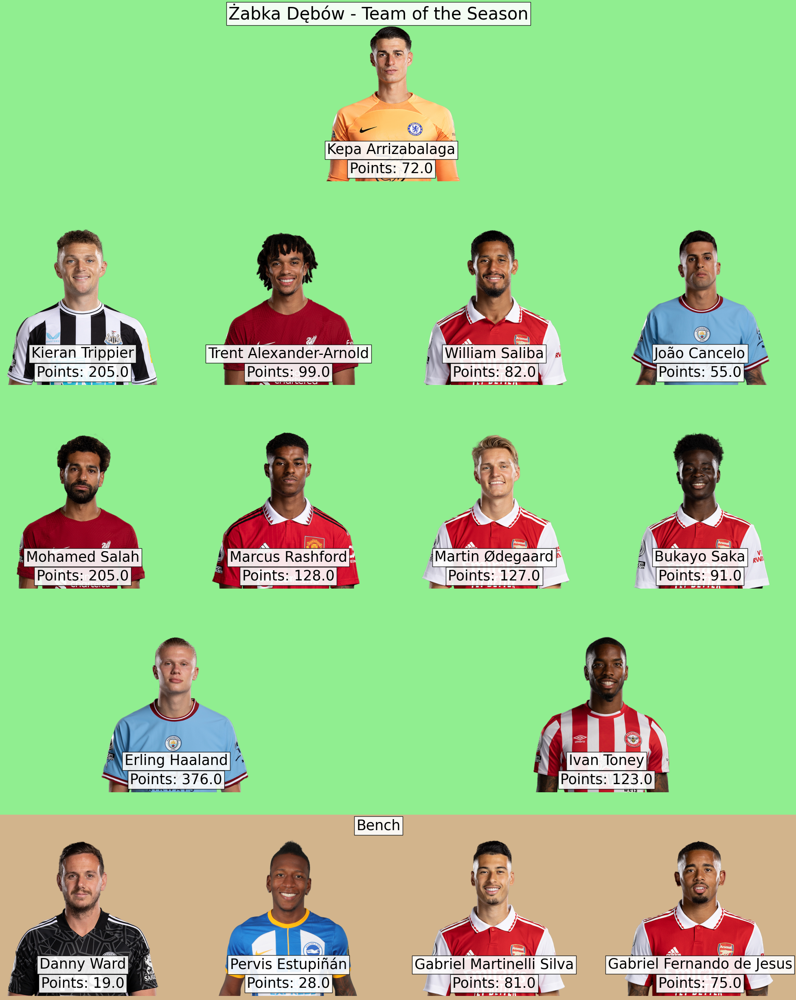

In [49]:
fig = plt.figure(figsize=(25,25))
subfigs = fig.subfigures(5, 1)
subfigs[0].suptitle(team_name+' - Team of the Season', ha='center', fontsize=30, bbox = dict(facecolor = 'white', alpha = 0.9),)
subfigs[0].set_facecolor('lightgreen')
ax0 = subfigs[0].subplots(1,1)
ax0.imshow(np.array(best_GK.iloc[0].image))
ax0.axis('off')
name = best_GK.iloc[0].first_name + " " + best_GK.iloc[0].second_name
points = "Points: " + str(best_GK.iloc[0]['sum'])
ax0.text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
           ha='center', va='center')
ax0.text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
           ha='center', va='center')
subfigs[1].set_facecolor('lightgreen')
ax1 = subfigs[1].subplots(1,4)
for i in range(4):
    ax1[i].imshow(np.array(best_DEF.iloc[i].image))
    name = best_DEF.iloc[i].first_name + " " + best_DEF.iloc[i].second_name
    points = "Points: " + str(best_DEF.iloc[i]['sum'])
    ax1[i].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax1[i].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax1[i].axis('off')
subfigs[2].set_facecolor('lightgreen')
ax2 = subfigs[2].subplots(1,4)
for i in range(4):
    ax2[i].imshow(np.array(best_MID.iloc[i].image))
    name = best_MID.iloc[i].first_name + " " + best_MID.iloc[i].second_name
    points = "Points: " + str(best_MID.iloc[i]['sum'])
    ax2[i].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax2[i].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax2[i].axis('off')
subfigs[3].set_facecolor('lightgreen')
ax3 = subfigs[3].subplots(1,2)
for i in range(2):
    ax3[i].imshow(np.array(best_FWD.iloc[i].image))
    name = best_FWD.iloc[i].first_name + " " + best_FWD.iloc[i].second_name
    points = "Points: " + str(best_FWD.iloc[i]['sum'])
    ax3[i].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax3[i].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax3[i].axis('off')
subfigs[4].set_facecolor('#d2b48c')
subfigs[4].suptitle('Bench', ha='center', fontsize=25, bbox = dict(facecolor = 'white', alpha = 0.9))
ax4 = subfigs[4].subplots(1,4)
ax4[0].imshow(np.array(best_GK.iloc[1].image))
name = best_GK.iloc[1].first_name + " " + best_GK.iloc[1].second_name
points = "Points: " + str(best_GK.iloc[1]['sum'])
ax4[0].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
           ha='center', va='center')
ax4[0].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
           ha='center', va='center')
ax4[0].axis('off')
ax4[1].imshow(np.array(best_DEF.iloc[4].image))
name = best_DEF.iloc[4].first_name + " " + best_DEF.iloc[4].second_name
points = "Points: " + str(best_DEF.iloc[4]['sum'])
ax4[1].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
           ha='center', va='center')
ax4[1].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
           ha='center', va='center')
ax4[1].axis('off')
ax4[2].imshow(np.array(best_MID.iloc[4].image))
name = best_MID.iloc[4].first_name + " " + best_MID.iloc[4].second_name
points = "Points: " + str(best_MID.iloc[4]['sum'])
ax4[2].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
           ha='center', va='center')
ax4[2].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
           ha='center', va='center')
ax4[2].axis('off')
ax4[3].imshow(np.array(best_FWD.iloc[2].image))
name = best_FWD.iloc[2].first_name + " " + best_FWD.iloc[2].second_name
points = "Points: " + str(best_FWD.iloc[2]['sum'])
ax4[3].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
           ha='center', va='center')
ax4[3].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
           ha='center', va='center')
ax4[3].axis('off')

fig.savefig(team_name+'_tots.png')

In next cells there is a code used to create TOTS for every team in league and whole league. Before running this code I downloaded images for every player to speed up process of squads visualisations.

In [54]:
LEAGUE_ID = 571786

In [55]:
url = 'https://fantasy.premierleague.com/api/leagues-classic/'+str(LEAGUE_ID)+'/standings/'
r = requests.get(url)
json = r.json()

In [28]:
pd.DataFrame(json['standings']['results'])

,id,event_total,player_name,rank,last_rank,rank_sort,total,entry,entry_name
0,16177720,58,Sebastian Piwko,1,1,1,2498,104060,ogurkinamizerie
1,41349409,77,Maciej Ficek,2,3,2,2466,5915452,Maciek
2,16230554,55,Marcin Piątek,3,2,3,2447,362998,FcPietki
3,27824708,67,Bartłomiej Fluda,4,4,4,2422,2664211,Sześćdziesiątki
4,16186098,63,Marcin Slys,5,5,5,2383,2798809,Żabka Dębów
5,34425908,66,Sławek Pilek,6,6,6,2368,779673,Polska Zbrojna
6,26434971,63,Carlos Alvarez Grygar,7,7,7,2316,303824,Obrigado Deus
7,16161548,56,Marek Mocny,8,8,8,2263,2794807,Husaria Chałupki
8,31856699,39,Mateusz Wrona,9,9,9,2217,4946010,speedi
9,42517429,59,Jakub Kukulski,10,10,10,2174,4830155,Change Name


In [56]:
def generate_tots_for_league(league_id):
    url = 'https://fantasy.premierleague.com/api/leagues-classic/'+str(league_id)+'/standings/'
    r = requests.get(url)
    json = r.json()
    league = pd.DataFrame(json['standings']['results'])
    league_name = json['league']['name']
    players_history = pd.DataFrame(columns=['element', 'fixture', 'opponent_team', 'total_points', 'was_home',
       'kickoff_time', 'team_h_score', 'team_a_score', 'round', 'minutes',
       'goals_scored', 'assists', 'clean_sheets', 'goals_conceded',
       'own_goals', 'penalties_saved', 'penalties_missed', 'yellow_cards',
       'red_cards', 'saves', 'bonus', 'bps', 'influence', 'creativity',
       'threat', 'ict_index', 'starts', 'expected_goals', 'expected_assists',
       'expected_goal_involvements', 'expected_goals_conceded', 'value',
       'transfers_balance', 'selected', 'transfers_in', 'transfers_out'])
    
    all_league_points = pd.DataFrame()
    
    for index, row in league.iterrows():
        print(row.entry_name)
        my_points = pd.DataFrame()
        for i in range(38):
            gw = i+1
            url = 'https://fantasy.premierleague.com/api/entry/'+str(row.entry)+'/event/'+str(gw)+'/picks/'
            r = requests.get(url)
            json_picks = r.json()
            colname='GW'+str(gw)
            print('GAMEWEEK '+str(gw))
            for el in json_picks['picks']:
                element_id = el['element']
                if element_id not in players_history.element.unique():
                    url = 'https://fantasy.premierleague.com/api/element-summary/'+str(element_id)+'/'
                    r = requests.get(url)
                    json = r.json()
                    history = pd.DataFrame(json['history'])
                    players_history = pd.concat([players_history, history])
                player_history = players_history[players_history['element'] == element_id]
                pts = np.sum(player_history[player_history['round'] == gw]['total_points'])
                my_points.loc[element_id, colname] = pts * el['multiplier']
        my_points['sum'] = np.sum(my_points, axis=1)
        all_league_points[row.entry_name] = my_points['sum']
        my_season = players.join(my_points, how='right')
        
        generate_tots_image(my_season, row.entry_name)
        
    all_league_points['sum'] = np.sum(all_league_points, axis=1)
    league_season = players.join(all_league_points, how='right')
    
    generate_tots_image(league_season, league_name)


In [57]:
def generate_tots_image(data, team_name):
    GK = data[data['position'] == 'Goalkeeper']
    DEF = data[data['position'] == 'Defender']
    MID = data[data['position'] == 'Midfielder']
    FWD = data[data['position'] == 'Forward']
    
    best_GK = GK.sort_values('sum', ascending=False).head(2)
    best_DEF = DEF.sort_values('sum', ascending=False).head(5)
    best_MID = MID.sort_values('sum', ascending=False).head(5)
    best_FWD = FWD.sort_values('sum', ascending=False).head(3)
    
    fig = plt.figure(figsize=(25,25))
    subfigs = fig.subfigures(5, 1)
    subfigs[0].suptitle(team_name+' - Team of the Season', ha='center', fontsize=30, bbox = dict(facecolor = 'white', alpha = 0.9),)
    subfigs[0].set_facecolor('lightgreen')
    ax0 = subfigs[0].subplots(1,1)
    ax0.imshow(np.array(best_GK.iloc[0].image))
    ax0.axis('off')
    name = best_GK.iloc[0].first_name + " " + best_GK.iloc[0].second_name
    points = "Points: " + str(best_GK.iloc[0]['sum'])
    ax0.text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax0.text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    subfigs[1].set_facecolor('lightgreen')
    ax1 = subfigs[1].subplots(1,4)
    for i in range(4):
        ax1[i].imshow(np.array(best_DEF.iloc[i].image))
        name = best_DEF.iloc[i].first_name + " " + best_DEF.iloc[i].second_name
        points = "Points: " + str(best_DEF.iloc[i]['sum'])
        ax1[i].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
                   ha='center', va='center')
        ax1[i].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
                   ha='center', va='center')
        ax1[i].axis('off')
    subfigs[2].set_facecolor('lightgreen')
    ax2 = subfigs[2].subplots(1,4)
    for i in range(4):
        ax2[i].imshow(np.array(best_MID.iloc[i].image))
        name = best_MID.iloc[i].first_name + " " + best_MID.iloc[i].second_name
        points = "Points: " + str(best_MID.iloc[i]['sum'])
        ax2[i].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
                   ha='center', va='center')
        ax2[i].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
                   ha='center', va='center')
        ax2[i].axis('off')
    subfigs[3].set_facecolor('lightgreen')
    ax3 = subfigs[3].subplots(1,2)
    for i in range(2):
        ax3[i].imshow(np.array(best_FWD.iloc[i].image))
        name = best_FWD.iloc[i].first_name + " " + best_FWD.iloc[i].second_name
        points = "Points: " + str(best_FWD.iloc[i]['sum'])
        ax3[i].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
                   ha='center', va='center')
        ax3[i].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
                   ha='center', va='center')
        ax3[i].axis('off')
    subfigs[4].set_facecolor('#d2b48c')
    subfigs[4].suptitle('Bench', ha='center', fontsize=25, bbox = dict(facecolor = 'white', alpha = 0.9))
    ax4 = subfigs[4].subplots(1,4)
    ax4[0].imshow(np.array(best_GK.iloc[1].image))
    name = best_GK.iloc[1].first_name + " " + best_GK.iloc[1].second_name
    points = "Points: " + str(best_GK.iloc[1]['sum'])
    ax4[0].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax4[0].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax4[0].axis('off')
    ax4[1].imshow(np.array(best_DEF.iloc[4].image))
    name = best_DEF.iloc[4].first_name + " " + best_DEF.iloc[4].second_name
    points = "Points: " + str(best_DEF.iloc[4]['sum'])
    ax4[1].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax4[1].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax4[1].axis('off')
    ax4[2].imshow(np.array(best_MID.iloc[4].image))
    name = best_MID.iloc[4].first_name + " " + best_MID.iloc[4].second_name
    points = "Points: " + str(best_MID.iloc[4]['sum'])
    ax4[2].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax4[2].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax4[2].axis('off')
    ax4[3].imshow(np.array(best_FWD.iloc[2].image))
    name = best_FWD.iloc[2].first_name + " " + best_FWD.iloc[2].second_name
    points = "Points: " + str(best_FWD.iloc[2]['sum'])
    ax4[3].text(250, 400, name, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax4[3].text(250, 460, points, fontsize=25, color='black', bbox = dict(facecolor = 'white', alpha = 0.9),
               ha='center', va='center')
    ax4[3].axis('off')

    fig.savefig(team_name+'_tots.png')

ogurkinamizerie
GAMEWEEK 1
GAMEWEEK 2
GAMEWEEK 3
GAMEWEEK 4
GAMEWEEK 5
GAMEWEEK 6
GAMEWEEK 7
GAMEWEEK 8
GAMEWEEK 9
GAMEWEEK 10
GAMEWEEK 11
GAMEWEEK 12
GAMEWEEK 13
GAMEWEEK 14
GAMEWEEK 15
GAMEWEEK 16
GAMEWEEK 17
GAMEWEEK 18
GAMEWEEK 19
GAMEWEEK 20
GAMEWEEK 21
GAMEWEEK 22
GAMEWEEK 23
GAMEWEEK 24
GAMEWEEK 25
GAMEWEEK 26
GAMEWEEK 27
GAMEWEEK 28
GAMEWEEK 29
GAMEWEEK 30
GAMEWEEK 31
GAMEWEEK 32
GAMEWEEK 33
GAMEWEEK 34
GAMEWEEK 35
GAMEWEEK 36
GAMEWEEK 37
GAMEWEEK 38
Maciek
GAMEWEEK 1
GAMEWEEK 2
GAMEWEEK 3
GAMEWEEK 4
GAMEWEEK 5
GAMEWEEK 6
GAMEWEEK 7
GAMEWEEK 8
GAMEWEEK 9
GAMEWEEK 10
GAMEWEEK 11
GAMEWEEK 12
GAMEWEEK 13
GAMEWEEK 14
GAMEWEEK 15
GAMEWEEK 16
GAMEWEEK 17
GAMEWEEK 18
GAMEWEEK 19
GAMEWEEK 20
GAMEWEEK 21
GAMEWEEK 22
GAMEWEEK 23
GAMEWEEK 24
GAMEWEEK 25
GAMEWEEK 26
GAMEWEEK 27
GAMEWEEK 28
GAMEWEEK 29
GAMEWEEK 30
GAMEWEEK 31
GAMEWEEK 32
GAMEWEEK 33
GAMEWEEK 34
GAMEWEEK 35
GAMEWEEK 36
GAMEWEEK 37
GAMEWEEK 38
FcPietki
GAMEWEEK 1
GAMEWEEK 2
GAMEWEEK 3
GAMEWEEK 4
GAMEWEEK 5
GAMEWEEK 6
GAMEWEEK

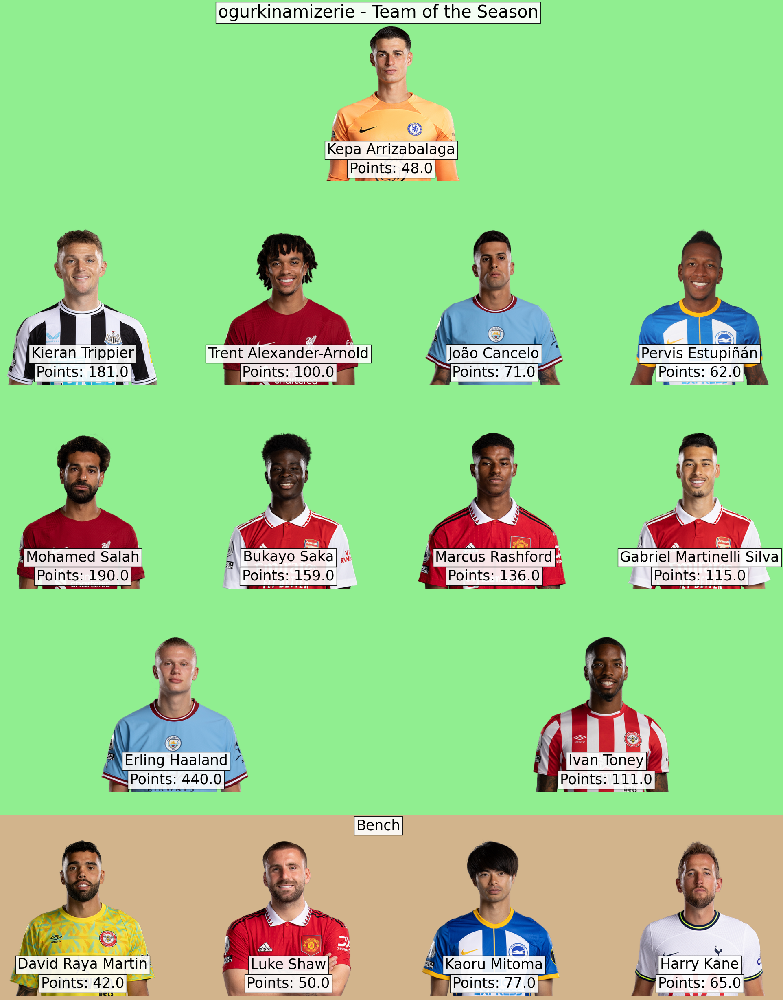

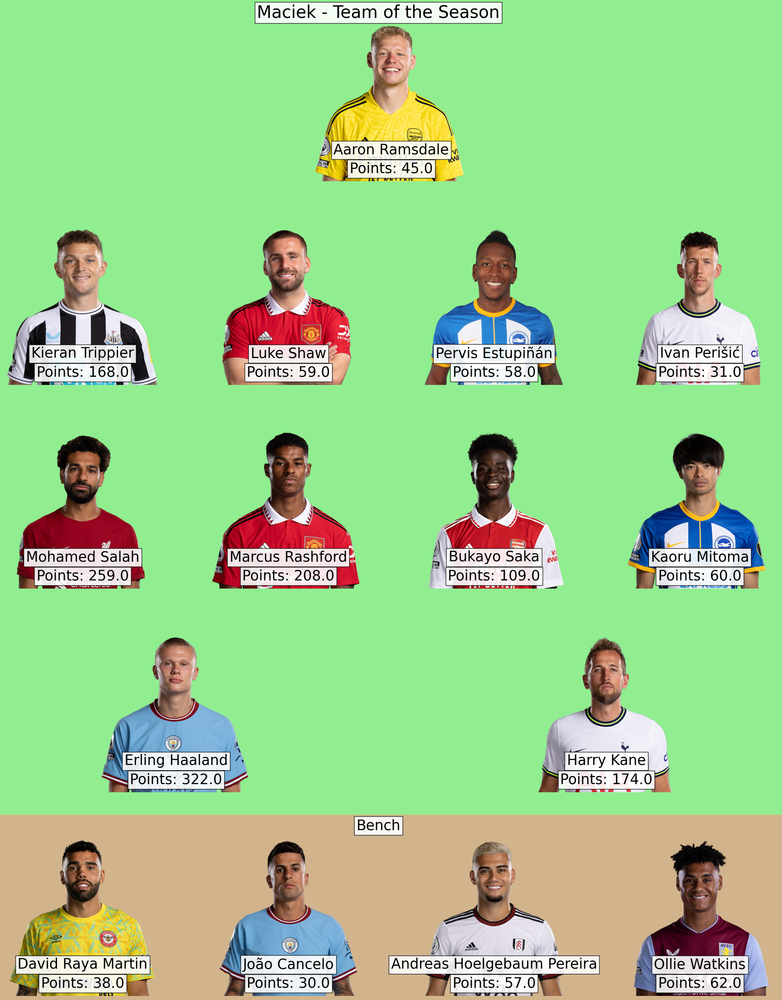

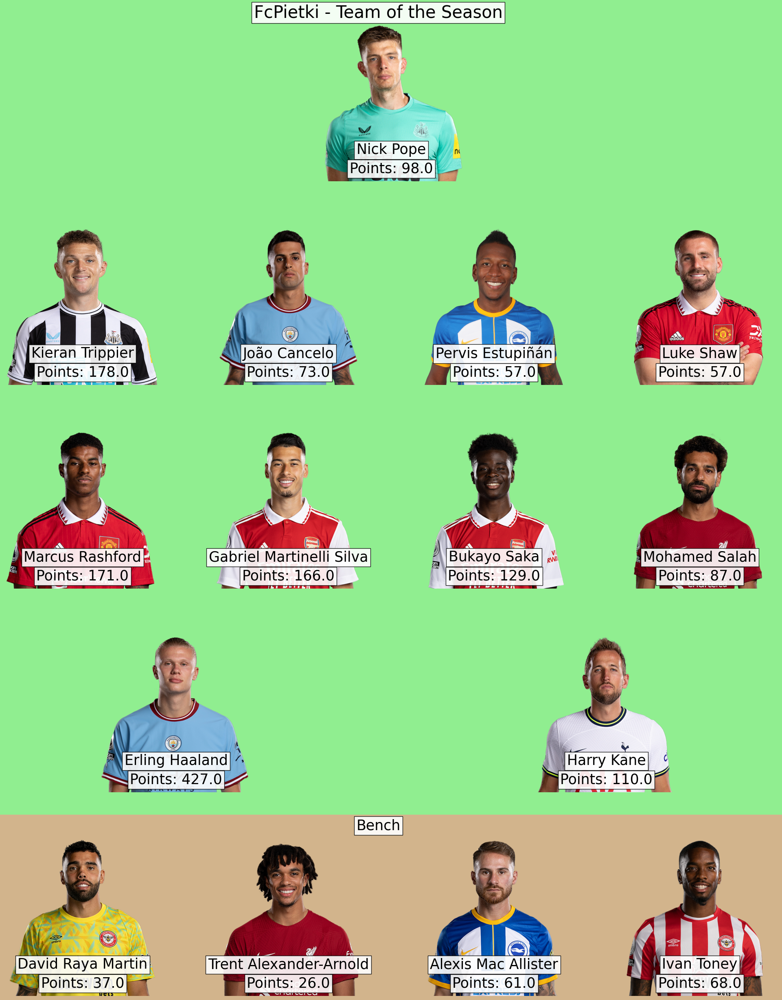

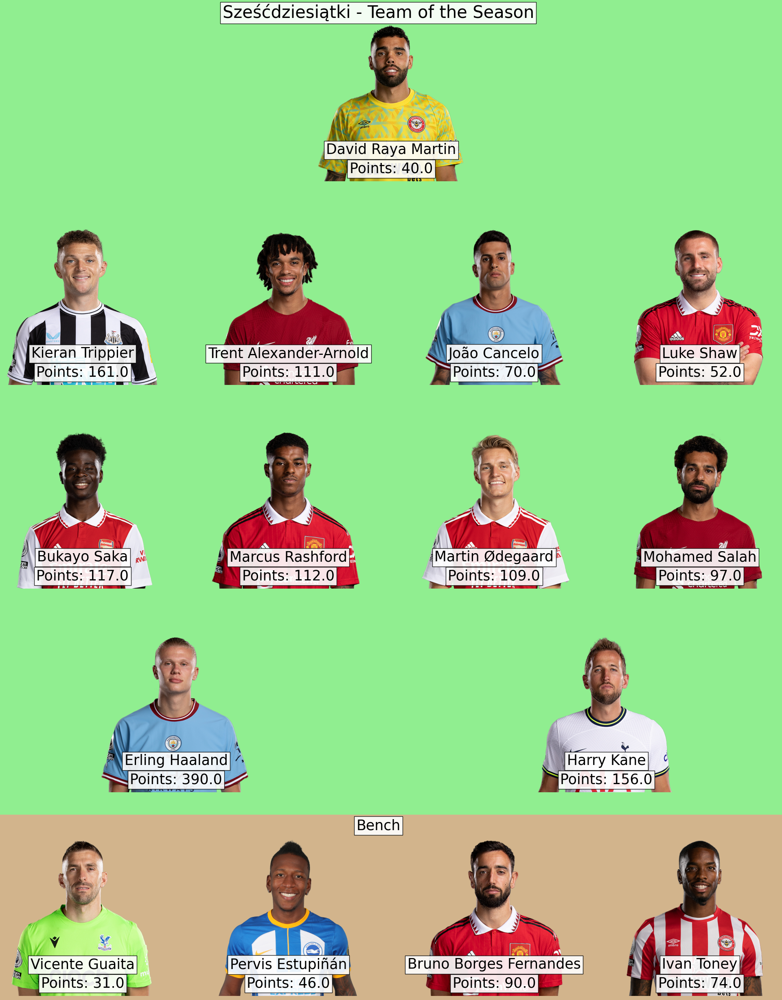

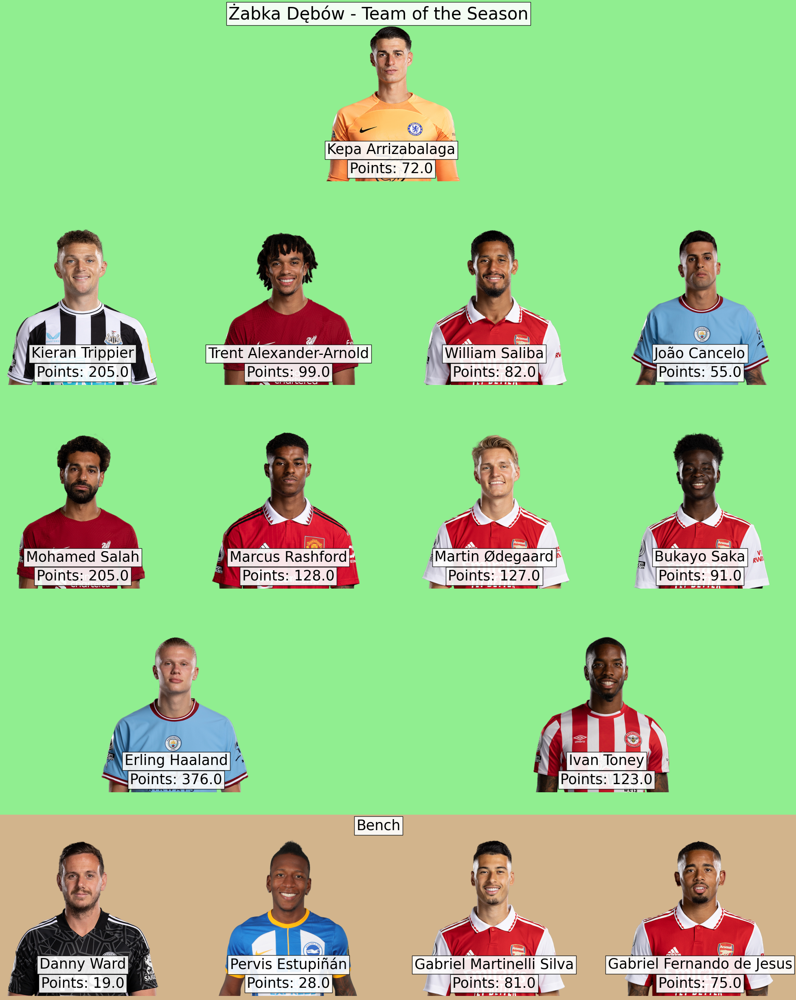

...

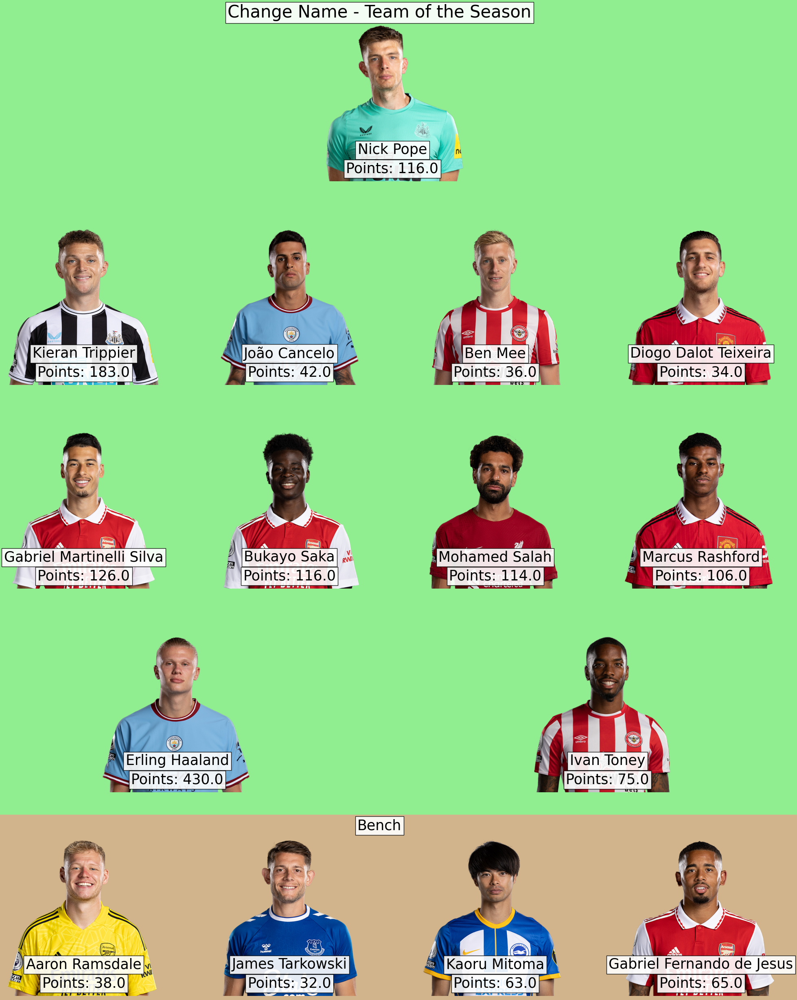

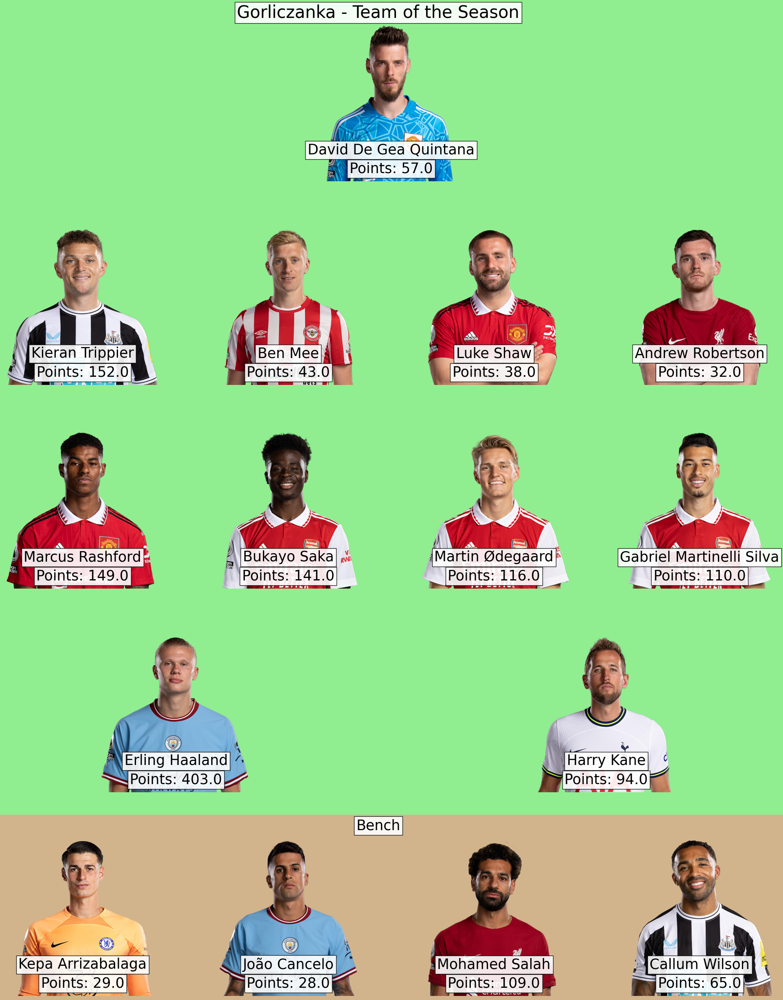

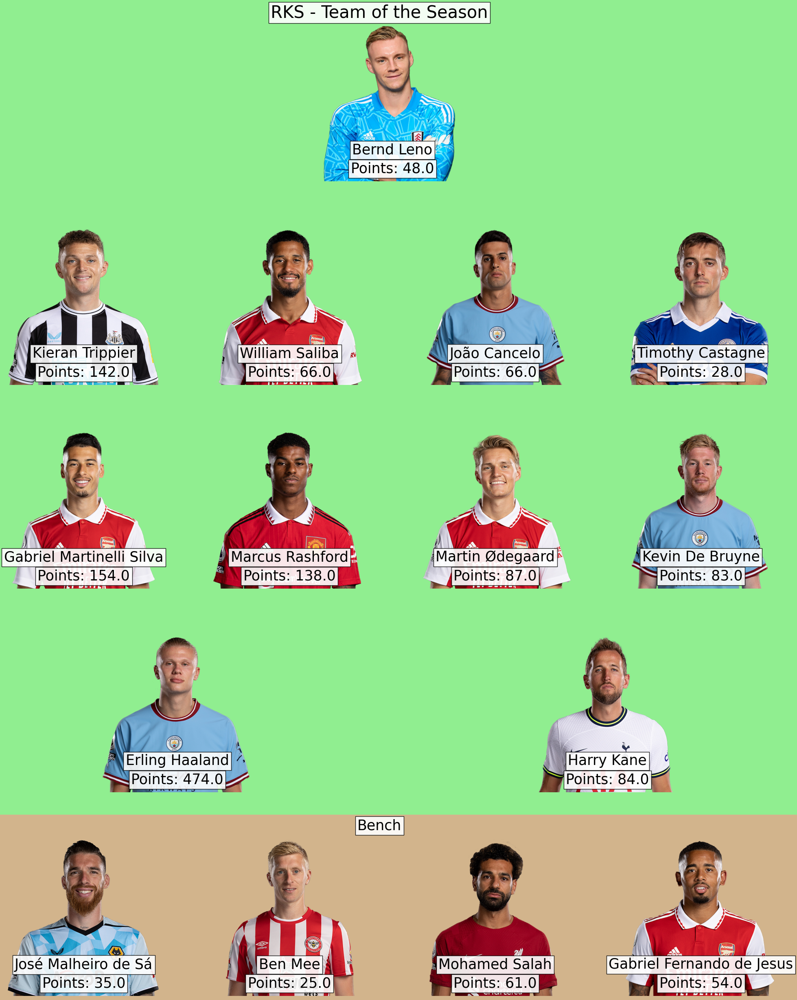

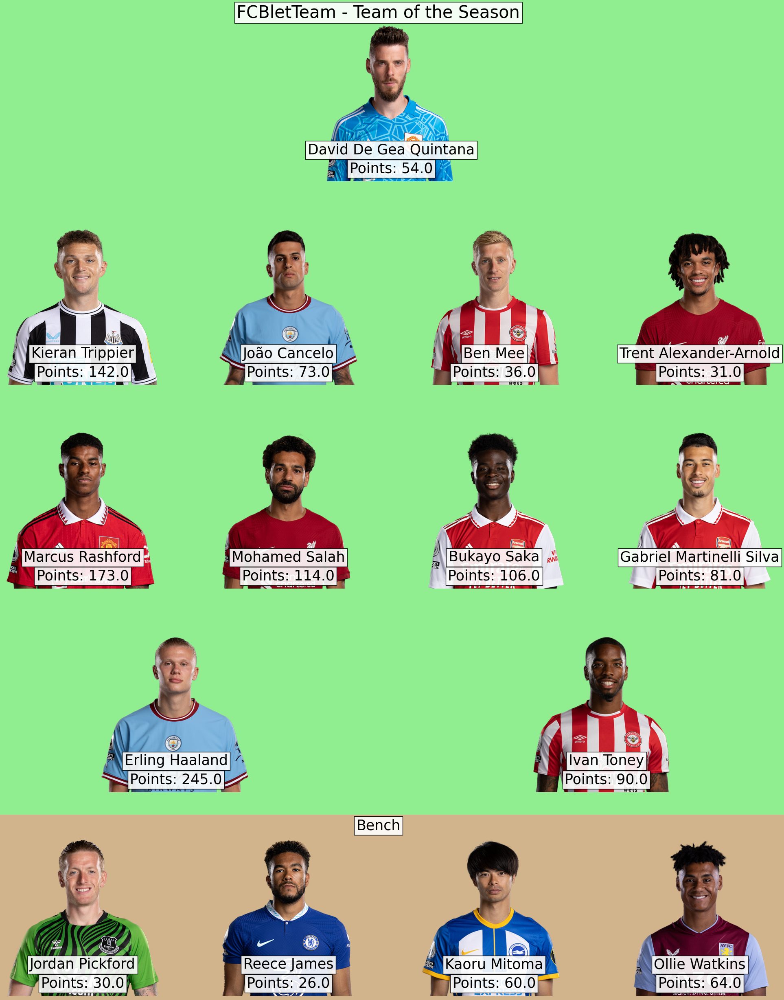

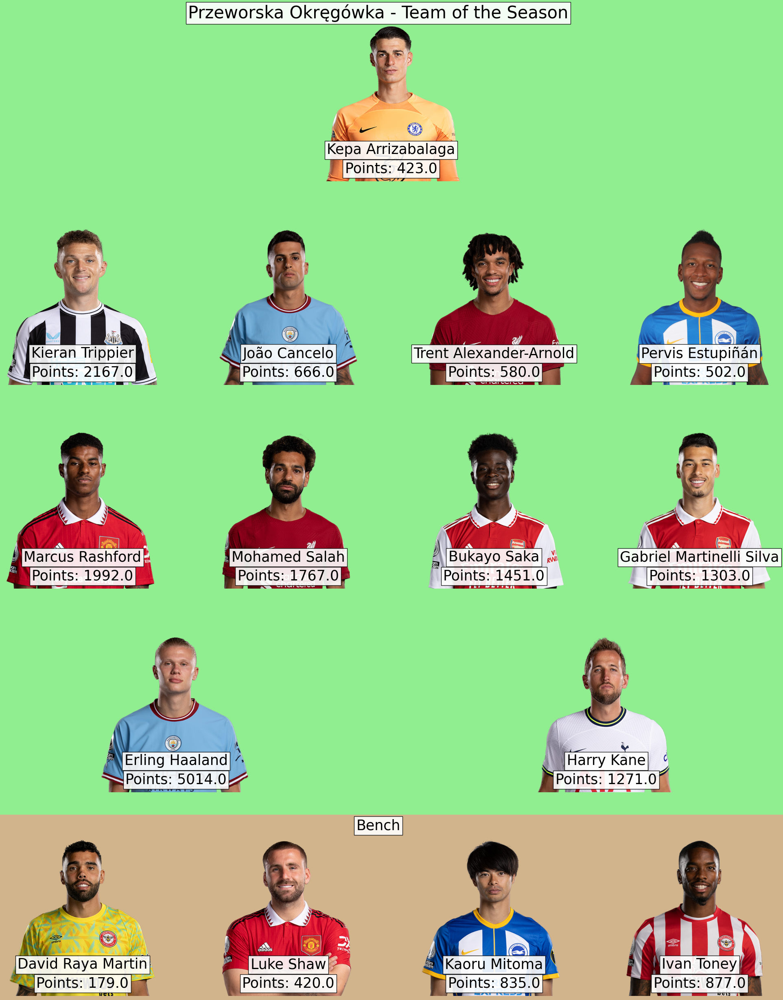

In [59]:
generate_tots_for_league(LEAGUE_ID)